# Notebook for Data Preprocessing and EDA.

<span style="font-size: larger;">**Continued from Merging Notebook:**</span>

As we've came up with a data model that aggregates all of the necessary data at each user level, now it's time to dig into data, try to unearth patterns and prepare our data for ML modelling.

<span style="font-size: larger;">**Proposed Solution:**</span>

In order to prepare tada and have all the methods reproducable my is as follows:
* Unified approach for data cleaning (missing data).
* Unified approach for feature engineering.
* Unified approach for feature encoding.
* Great feature selection;
* Perform cross validation;
* Tune model on the AUC score.
* Evaluate predictions.

# Data Preprocessing.

## Data Collection.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from ydata_profiling import ProfileReport
from statsmodels.stats.proportion import proportions_ztest
import tools
import scipy.stats as stats

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
%matplotlib inline
warnings.filterwarnings("ignore")

In [3]:
file_path = '/Users/taurasaleksandravicius/Desktop/Personal/TC/Projects/taleks-ML.4.1/data/'

df = pd.read_csv(f"{file_path}merged_data.csv", index_col = 0)

In [4]:
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,SK_ID_CURR_COUNT_PRV,AMT_ANNUITY_MEAN_PRV,AMT_ANNUITY_SUM_PRV,AMT_CREDIT_MEAN_PRV,AMT_CREDIT_SUM_PRV,DAYS_DECISION_MEAN_PRV,CNT_PAYMENT_MEAN_PRV,CNT_PAYMENT_SUM_PRV,RATE_DOWN_PAYMENT_MEAN_PRV,DAYS_LAST_DUE_MEAN_PRV,DAYS_TERMINATION_MEAN_PRV,NAME_CONTRACT_STATUS_PRV,PRODUCT_COMBINATION_PRV,NAME_YIELD_GROUP_PRV,STATUS_APPROVED_COUNT_PRV,STATUS_CANCELED_COUNT_PRV,STATUS_REFUSED_COUNT_PRV,STATUS_UNUSED OFFER_COUNT_PRV,AMT_BALANCE_CREDIT-CARD,AMT_CREDIT_LIMIT_ACTUAL_CREDIT-CARD,AMT_DRAWINGS_CURRENT_CREDIT-CARD,AMT_PAYMENT_CURRENT_CREDIT-CARD,CNT_DRAWINGS_CURRENT_CREDIT-CARD,SK_DPD_CREDIT-CARD,NAME_CONTRACT_STATUS_CREDIT-CARD,CREDIT_DAY_OVERDUE_BUR,DAYS_CREDIT_ENDDATE_BUR,AMT_CREDIT_SUM_BUR,AMT_CREDIT_SUM_DEBT_BUR,AMT_CREDIT_SUM_OVERDUE_BUR,CNT_CREDIT_PROLONG_BUR,CREDIT_ACTIVE_BUR,CNT_INSTALMENT_POS,CNT_INSTALMENT_FUTURE_POS,NAME_CONTRACT_STATUS_POS,SK_DPD_POS,SK_DPD_DEF_POS,COUNT_ON_TIME_PAYMENTS_INST,COUNT_LATE_PAYMENTS_INST
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,9251.775,9251.775,179055.00,179055.0,-606.000000,24.000000,24.0,0.000000,-25.000000,-17.000000,Approved,POS other with interest,low_nor

## Data Preprocessing.

Now let's check some descriptive statistics about features.

In [5]:
tools.summary(df)

Dataframe shape: (307511, 161)


,Data Type,# Unique,Missing,Missing %,Min,Max,Mean,Standard Deviation
SK_ID_CURR,int64,307511,0,0.0,100002.0,456255.0,278180.518577,102790.175348
TARGET,int64,2,0,0.0,0.0,1.0,0.080729,0.272419
NAME_CONTRACT_TYPE,object,2,0,0.0,NaN,NaN,NaN,NaN
CODE_GENDER,object,3,0,0.0,NaN,NaN,NaN,NaN
FLAG_OWN_CAR,object,2,0,0.0,NaN,NaN,NaN,NaN
FLAG_OWN_REALTY,object,2,0,0.0,NaN,NaN,NaN,NaN
CNT_CHILDREN,int64,15,0,0.0,0.0,19.0,0.417052,0.722121
AMT_INCOME_TOTAL,float64,2548,0,0.0,25650.0,117000000.0,168797.919297,237123.146279
AMT_CREDIT,float64,5603,0,0.0,45000.0,4050000.0,599025.999706,402490.776996
AMT_ANNUITY,float64,13672,12,0.0,1615.5,258025.5,27108.573909,14493.737315


Ok. Let's not rush too much and analyze some key features, their interactions with target and also target itself.

# EDA Part 1 - Univariate Analysis.

### Feature classification.

Since. There are simply too many features, let's put existing application data features into different groups and analyze each group one by one within the group and against the target.

In [48]:
demographics = ['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR',
                'FLAG_OWN_REALTY', 'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE',
                'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
                'NAME_HOUSING_TYPE', 'OCCUPATION_TYPE', 'ORGANIZATION_TYPE']

count = ['CNT_CHILDREN', 'CNT_FAM_MEMBERS']

duration = ['DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION',
            'DAYS_ID_PUBLISH', 'DAYS_LAST_PHONE_CHANGE', 'OWN_CAR_AGE']

    
social = ['OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
          'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE']

contact = ['FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE',
           'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL',
           'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
           'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
           'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY']

region_process_external_amount = ['REGION_POPULATION_RELATIVE', 'REGION_RATING_CLIENT',
          'REGION_RATING_CLIENT_W_CITY', 'HOUR_APPR_PROCESS_START', 'WEEKDAY_APPR_PROCESS_START',
                                  'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3',
                                  'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE']

requests = ['AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
           'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
           'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']

document = ['FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_4',
            'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_7',
            'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_9', 'FLAG_DOCUMENT_10',
            'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_12', 'FLAG_DOCUMENT_13',
            'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15', 'FLAG_DOCUMENT_16',
            'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19',
            'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21']

building = ['APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG',
            'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG',
            'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG',
            'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG',
            'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE',
            'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE',
            'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE',
            'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE',
            'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE',
            'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI',
            'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI',
            'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', 'ELEVATORS_MEDI',
            'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI', 'LANDAREA_MEDI',
            'LIVINGAPARTMENTS_MEDI', 'LIVINGAREA_MEDI', 'NONLIVINGAPARTMENTS_MEDI',
            'NONLIVINGAREA_MEDI', 'FONDKAPREMONT_MODE', 'HOUSETYPE_MODE',
            'TOTALAREA_MODE', 'WALLSMATERIAL_MODE', 'EMERGENCYSTATE_MODE']

### Feature group - Demographics.

In [12]:
df_demographics = pd.concat([df[demographics], df['TARGET']], axis=1)

df_demographics.head(2)

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE,ORGANIZATION_TYPE,TARGET
0,Cash loans,M,N,Y,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Laborers,Business Entity Type 3,1
1,Cash loans,F,N,N,Family,State servant,Higher education,Married,House / apartment,Core staff,School,0


In [ ]:
profile = ProfileReport(df_demographics, title="Profiling Report", explorative=True)

In [11]:
profile

**Conclusion from demographics:**
* 27k duplicated rows.
* Cash Loans are most popular ones;
* XNA gender has only 4 occcurances - will drop it.
* Occupation Type - many missing values (31%). Its not data collection problem. Will be imputed by 'Unknown'.
* Occupation Type and Gender are correlated. However none of them correlated to the target feature.

**TLDR: no big problems with missing data, drop XNA from gender, fill in Occupation Type with Unknown, rest median or mode.**

### Feature group - Count.

In [14]:
df_count = pd.concat([df[count], df['TARGET']], axis=1)

df_count.head(2)

,CNT_CHILDREN,CNT_FAM_MEMBERS,TARGET
0,0,1.0,1
1,0,2.0,0


In [17]:
profile = ProfileReport(df_count, title="Profiling Report", explorative=True)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [18]:
profile

**Conclusion from count:**
* 70% people dont have kids.
* Maximum is 19 kids.
* Maximum is 20 family members

**TLDR: keep as it is.(discrete values)**

### Feature group - Duration.

In [20]:
df_duration = pd.concat([df[duration], df['TARGET']], axis=1)

df_duration.head(2)

,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,DAYS_LAST_PHONE_CHANGE,OWN_CAR_AGE,TARGET
0,-9461,-637,-3648.0,-2120,-1134.0,NaN,1
1,-16765,-1188,-1186.0,-291,-828.0,NaN,0


In [21]:
profile = ProfileReport(df_duration, title="Profiling Report", explorative=True)

In [23]:
profile

**Conclusion from duration features:**
* Days Employed has placeholder - 365243, need to drop it.
* Own_Car_age - drop this feature. 66% are missing and probably not so useful.

**TLDR: drop a placeholder from days employed and drop own_car_age feature**

### Feature group - Social.

In [24]:
df_social = pd.concat([df[social], df['TARGET']], axis=1)

df_social.head(2)

,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,TARGET
0,2.0,2.0,2.0,2.0,1
1,1.0,0.0,1.0,0.0,0


In [25]:
profile = ProfileReport(df_social, title="Profiling Report", explorative=True)

In [27]:
profile

**Conclusion from duration features:**
* DEF_60_CNT_SOCIAL_CIRCLE - has 91 % data of Zeros, will drop it.

**TLDR: drop DEF_60_CNT_SOCIAL_CIRCLE.**

### Feature group - Contact.

In [29]:
df_contact = pd.concat([df[contact], df['TARGET']], axis=1)

df_contact.head(2)

,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,TARGET
0,1,1,0,1,1,0,1
1,1,1,0,1,1,0,0


In [30]:
profile = ProfileReport(df_contact, title="Profiling Report", explorative=True)

In [32]:
profile

**Conclusion from duration features:**
* FLAG_MOBIL - drop, useless;
* FLAG_CONT_MOBILE - drop.
* FLAG_EMAIL - drop.
* No significant correlations observed.

**TLDR: drop FLAG_MOBIL,FLAG_CONT_MOBILE, FLAG_EMAIL .**

### Feature group - Region, Process, External and Amount.

In [36]:
df_region_process_external_amount = pd.concat([df[region_process_external_amount], df['TARGET']], axis=1)

df_region_process_external_amount.head(2)

,REGION_POPULATION_RELATIVE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,WEEKDAY_APPR_PROCESS_START,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,TARGET
0,0.018801,2,2,10,WEDNESDAY,0.083037,0.262949,0.139376,202500.0,406597.5,24700.5,351000.0,1
1,0.003541,1,1,11,MONDAY,0.311267,0.622246,NaN,270000.0,1293502.5,35698.5,1129500.0,0


In [37]:
profile = ProfileReport(df_region_process_external_amount, title="Profiling Report", explorative=True)

In [39]:
profile

**Conclusion from regional, process, external and amount features:**
* EXT_SOURCE_1 normally distributed bus tas 56% missing values. Probably will be dropped.
* EXT_SOURCE_3 20% missing data.

**TLDR: drop EXT_SOURCE_1, impute EXT_SOURCE_3.**

### Feature group - Requests.

In [49]:
df_requests = pd.concat([df[requests], df['TARGET']], axis=1)

df_requests.head(2)

,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,TARGET
0,0.0,0.0,0.0,0.0,0.0,1.0,1
1,0.0,0.0,0.0,0.0,0.0,0.0,0


In [50]:
profile = ProfileReport(df_requests, title="Profiling Report", explorative=True)

In [52]:
profile

**Conclusion from regional, process, external and amount features:**
* All timeframes have equal amount if missing values.
* Will be imputed with median value (will be 0 for all these rows.
   
**TLDR: impute with median value all requests data**.

### Feature group - Documents.

In [54]:
df_document = pd.concat([df[document], df['TARGET']], axis=1)

df_document.head(2)

,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,TARGET
0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [55]:
profile = ProfileReport(df_document, title="Profiling Report", explorative=True)

In [57]:
profile

**Conclusion from regional, process, external and amount features:**
* Keep only documents 3, 6, 8, because they have some variation.
  

### Feature group - Building.

In [58]:
df_building = pd.concat([df[building], df['TARGET']], axis=1)

df_building.head(2)

,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,TARGET
0,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,1
1,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,0


In [59]:
# profile = ProfileReport(df_building, title="Profiling Report", explorative=True)

**Conclusion from regional, process, external and amount features:**
* Whole Building data has from 48% to 67% missing data. Clearly issues with data collection. We will drop these columns and they will not be used for modelling.
  

Centralized conclusion from exploratory data analysis:
* demographics : no big problems with missing data, drop XNA from gender, fill in Occupation Type with Unknown, rest median or mode.
* count: keep as it is.(discrete values)
* duration: drop a placeholder from days employed and drop own_car_age feature
* social: drop DEF_60_CNT_SOCIAL_CIRCLE.
* contact: drop FLAG_MOBIL,FLAG_CONT_MOBILE, FLAG_EMAIL .
* region, process, external, amount: drop EXT_SOURCE_1, impute EXT_SOURCE_3.
* requests:  impute with median value all requests data.
* document: Keep only documents 3, 6, 8, because they have some variation.
* building: Whole Building data has from 48% to 67% missing data. Clearly issues with data collection. We will drop these columns and they will not be used for modelling.

## Dropping Unnecessary Columns.

In [66]:
drop_columns = [
    'OWN_CAR_AGE',  # duration
    'DEF_60_CNT_SOCIAL_CIRCLE',  # social
    'FLAG_MOBIL', 'FLAG_CONT_MOBILE', 'FLAG_EMAIL',  # contact
    'EXT_SOURCE_1',  # external
    'FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_7', 'FLAG_DOCUMENT_9', 
    'FLAG_DOCUMENT_10', 'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_12', 'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 
    'FLAG_DOCUMENT_15', 'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 
    'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21',  # document
    'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 
    'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 
    'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 
    'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE', 
    'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 
    'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI', 
    'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', 'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI', 
    'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI', 'LIVINGAREA_MEDI', 'NONLIVINGAPARTMENTS_MEDI', 'NONLIVINGAREA_MEDI', 
    'FONDKAPREMONT_MODE', 'HOUSETYPE_MODE', 'TOTALAREA_MODE', 'WALLSMATERIAL_MODE', 'EMERGENCYSTATE_MODE' # building
]

df.drop(columns=drop_columns, inplace=True)


In [67]:
df.shape

(307511, 91)

In [68]:
df.head(2)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,FLAG_DOCUMENT_8,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,SK_ID_CURR_COUNT_PRV,AMT_ANNUITY_MEAN_PRV,AMT_ANNUITY_SUM_PRV,AMT_CREDIT_MEAN_PRV,AMT_CREDIT_SUM_PRV,DAYS_DECISION_MEAN_PRV,CNT_PAYMENT_MEAN_PRV,CNT_PAYMENT_SUM_PRV,RATE_DOWN_PAYMENT_MEAN_PRV,DAYS_LAST_DUE_MEAN_PRV,DAYS_TERMINATION_MEAN_PRV,NAME_CONTRACT_STATUS_PRV,PRODUCT_COMBINATION_PRV,NAME_YIELD_GROUP_PRV,STATUS_APPROVED_COUNT_PRV,STATUS_CANCELED_COUNT_PRV,STATUS_REFUSED_COUNT_PRV,STATUS_UNUSED OFFER_COUNT_PRV,AMT_BALANCE_CREDIT-CARD,AMT_CREDIT_LIMIT_ACTUAL_CREDIT-CARD,AMT_DRAWINGS_CURRENT_CREDIT-CARD,AMT_PAYMENT_CURRENT_CREDIT-CARD,CNT_DRAWINGS_CURRENT_CREDIT-CARD,SK_DPD_CREDIT-CARD,NAME_CONTRACT_STATUS_CREDIT-CARD,CREDIT_DAY_OVERDUE_BUR,DAYS_CREDIT_ENDDATE_BUR,AMT_CREDIT_SUM_BUR,AMT_CREDIT_SUM_DEBT_BUR,AMT_CREDIT_SUM_OVERDUE_BUR,CNT_CREDIT_PROLONG_BUR,CREDIT_ACTIVE_BUR,CNT_INSTALMENT_POS,CNT_INSTALMENT_FUTURE_POS,NAME_CONTRACT_STATUS_POS,SK_DPD_POS,SK_DPD_DEF_POS,COUNT_ON_TIME_PAYMENTS_INST,COUNT_LATE_PAYMENTS_INST
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,1,0,1,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,2.0,2.0,2.0,-1134.0,1,0,0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,9251.775,9251.775,179055.0,179055.0,-606.0,24.0,24.0,0.00000,-25.000000,-17.000000,Approved,POS other with interest,low_normal,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,-349.0,108131.945625,49156.2,0.0,0.0,Closed,24.0,6.0,Active,0.0,0.0,19.0,0.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,1,0,1,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,1.0,0.0,1.0,-828.0,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,56553.990,169661.970,484191.0,1452573.0,-1305.0,10.0,30.0,0.05003,-1054.333333,-1047.333333,Approved,Cash X-Sell: low,middle,3.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,-544.5,254350.125000,0.0,0.0,0.0,Active,7.0,0.0,Completed,0.0,0.0,25.0,0.0


## Further Feature selection: Initial Mutual Information and Correlation Analysis.

Furthermore, in this project, I will use a mutual information classifier to capture non-linear relationships between variables and determine which features provide no information about the target.

Correlation analysis will help identify any linear relationships between features.

My strategy is to identify and drop features that have no information value or correlation with the target.

## Initial Mutual Info

Let's maintain integrity of the whole dataset, let's take a look at whats the mutual information provided by features against target. Let's impute all missing values with mode or median.

In [69]:
df_mif = df.copy()

In [70]:
from sklearn.feature_selection import mutual_info_classif

categorical_cols = df_mif.select_dtypes(include=['object']).columns.tolist()
numerical_cols = df_mif.select_dtypes(include=['number']).columns.tolist()

for col in categorical_cols:
    df_mif[col].fillna(df_mif[col].mode()[0], inplace=True)

for col in numerical_cols:
    df_mif[col].fillna(df_mif[col].median(), inplace=True)

target_col = 'TARGET'
X = df_mif.drop(columns=[target_col])
y = df_mif[target_col]

if y.dtype == 'object':
    y, _ = y.factorize()

X_train, y_train, X_val, y_val, X_test, y_test = tools.stratified_train_val_test_split(df_mif, target_col='TARGET')

for colname in X_train.select_dtypes('object'):
    X_train[colname], _ = X_train[colname].factorize()

mi_scores = mutual_info_classif(X_train, y_train, random_state=42)
mi_scores_series = pd.Series(mi_scores, name="MI Scores", index=X_train.columns)

mi_scores_series.sort_values(ascending=False, inplace=True)
mi_scores_series

FLAG_EMP_PHONE                         0.031254
CODE_GENDER                            0.030716
FLAG_OWN_CAR                           0.030696
FLAG_DOCUMENT_3                        0.029895
AMT_PAYMENT_CURRENT_CREDIT-CARD        0.016208
AMT_CREDIT_LIMIT_ACTUAL_CREDIT-CARD    0.015956
REGION_RATING_CLIENT_W_CITY            0.015836
REGION_RATING_CLIENT                   0.015539
NAME_CONTRACT_STATUS_POS               0.015520
CREDIT_ACTIVE_BUR                      0.015111
EXT_SOURCE_3                           0.014454
CNT_FAM_MEMBERS                        0.013907
AMT_ANNUITY                            0.011882
EXT_SOURCE_2                           0.011301
FLAG_PHONE                             0.008737
DAYS_EMPLOYED                          0.008180
FLAG_OWN_REALTY                        0.007764
NAME_YIELD_GROUP_PRV                   0.007648
AMT_BALANCE_CREDIT-CARD                0.007311
NAME_INCOME_TYPE                       0.007306
NAME_EDUCATION_TYPE                    0

Interesting! Some features are more important than others! Also there are features that provide zero information on target! Lets keep them and check on the correlations. 

## Correlation analysis

In [72]:
df_corr = df.copy()

In [73]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le_count = 0

for col in df:
    if df_corr[col].dtype == 'object':
        # If 2 or fewer unique categories
        if len(list(df_corr[col].unique())) <= 2:
            le.fit(df_corr[col])
            df_corr[col] = le.transform(df_corr[col])
            
            # Keep track of how many columns were label encoded
            le_count += 1
            
print('%d columns were label encoded.' % le_count)

3 columns were label encoded.


In [74]:
df_corr = pd.get_dummies(df_corr)

In [83]:
df_corr.head(2)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,FLAG_DOCUMENT_8,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,SK_ID_CURR_COUNT_PRV,AMT_ANNUITY_MEAN_PRV,AMT_ANNUITY_SUM_PRV,AMT_CREDIT_MEAN_PRV,AMT_CREDIT_SUM_PRV,DAYS_DECISION_MEAN_PRV,CNT_PAYMENT_MEAN_PRV,CNT_PAYMENT_SUM_PRV,RATE_DOWN_PAYMENT_MEAN_PRV,DAYS_LAST_DUE_MEAN_PRV,DAYS_TERMINATION_MEAN_PRV,STATUS_APPROVED_COUNT_PRV,STATUS_CANCELED_COUNT_PRV,STATUS_REFUSED_COUNT_PRV,STATUS_UNUSED OFFER_COUNT_PRV,AMT_BALANCE_CREDIT-CARD,AMT_CREDIT_LIMIT_ACTUAL_CREDIT-CARD,AMT_DRAWINGS_CURRENT_CREDIT-CARD,AMT_PAYMENT_CURRENT_CREDIT-CARD,CNT_DRAWINGS_CURRENT_CREDIT-CARD,SK_DPD_CREDIT-CARD,CREDIT_DAY_OVERDUE_BUR,DAYS_CREDIT_ENDDATE_BUR,AMT_CREDIT_SUM_BUR,AMT_CREDIT_SUM_DEBT_BUR,AMT_CREDIT_SUM_OVERDUE_BUR,CNT_CREDIT_PROLONG_BUR,CNT_INSTALMENT_POS,CNT_INSTALMENT_FUTURE_POS,SK_DPD_POS,SK_DPD_DEF_POS,COUNT_ON_TIME_PAYMENTS_INST,COUNT_LATE_PAYMENTS_INST,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGANIZATION_TYPE_Cleaning,ORGANIZATION_TYPE_Construction,ORGANIZATION_TYPE_Culture,ORGANIZATION_TYPE_Electricity,ORGANIZATION_TYPE_Emergency,ORGANIZATION_TYPE_Government,ORGANIZATION_TYPE_Hotel,ORGANIZATION_TYPE_Housing,ORGANIZATION_TYPE_Industry: type 1,ORGANIZATION_TYPE_Industry: type 10,ORGANIZATION_TYPE_Industry: type 11

In [75]:
correlations = df_corr.corr()['TARGET'].sort_values()

print('Most Positive Correlations:\n', correlations.tail(15))
print('\nMost Negative Correlations:\n', correlations.head(15))

Most Positive Correlations:
 NAME_EDUCATION_TYPE_Secondary / secondary special    0.049824
REG_CITY_NOT_WORK_CITY                               0.050994
DAYS_ID_PUBLISH                                      0.051457
CODE_GENDER_M                                        0.054713
DAYS_LAST_PHONE_CHANGE                               0.055218
NAME_INCOME_TYPE_Working                             0.057481
AMT_DRAWINGS_CURRENT_CREDIT-CARD                     0.058732
REGION_RATING_CLIENT                                 0.058899
REGION_RATING_CLIENT_W_CITY                          0.060893
NAME_CONTRACT_STATUS_PRV_Refused                     0.063064
STATUS_REFUSED_COUNT_PRV                             0.064469
DAYS_BIRTH                                           0.078239
CNT_DRAWINGS_CURRENT_CREDIT-CARD                     0.082520
AMT_BALANCE_CREDIT-CARD                              0.087177
TARGET                                               1.000000
Name: TARGET, dtype: float64

Most Negati

In [79]:
# There are 3 features that have no correlation and have no information on the target feature, its:

features_drop = ['STATUS_UNUSED OFFER_COUNT_PRV', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_HOUR']

In [ ]:
df.drop(columns=features_drop, inplace=True)

In [33]:
df.drop(df[df['CODE_GENDER'] == 'XNA'].index, inplace = True)

## EDA Part 2: Interactions between features.

In this part my strategy is to take most important numeric/ categoric features based by MIF and prepare grounds for Feature Engineering. It makes sense to create additional features (like polynomials, log and etc.) out of the ones, that are already informative. Interaction terms between two features can help to unearth even more information about target.

Prior leaking any knowledge let's do a train-val-test split.

Since we have way too many features out here I will pick features that grab attention the most, as the ultimate goal of this part is to come up with ideas for feature engineering. <br>
**My selecton criterion is:**
* MIF score above 0.01;
* Positive correlaton above 0.06 and Negative correlation below -0.1; 

In [26]:
categorical_features = [
    'CODE_GENDER',
    'FLAG_OWN_CAR',
    'NAME_CONTRACT_STATUS_POS',
    'CREDIT_ACTIVE_BUR',
    'NAME_CONTRACT_STATUS_PRV',
    'FLAG_EMP_PHONE',
    'FLAG_DOCUMENT_3',
    'REGION_RATING_CLIENT_W_CITY',
    'REGION_RATING_CLIENT']

numerical_features = [
    'AMT_PAYMENT_CURRENT_CREDIT-CARD',
    'AMT_CREDIT_LIMIT_ACTUAL_CREDIT-CARD',
    'EXT_SOURCE_3',
    'CNT_FAM_MEMBERS',
    'AMT_ANNUITY',
    'EXT_SOURCE_2',
    'STATUS_REFUSED_COUNT_PRV',
    'DAYS_BIRTH',
    'CNT_DRAWINGS_CURRENT_CREDIT-CARD',
    'AMT_BALANCE_CREDIT-CARD']

### Numeric Feature vs Target Analysis.

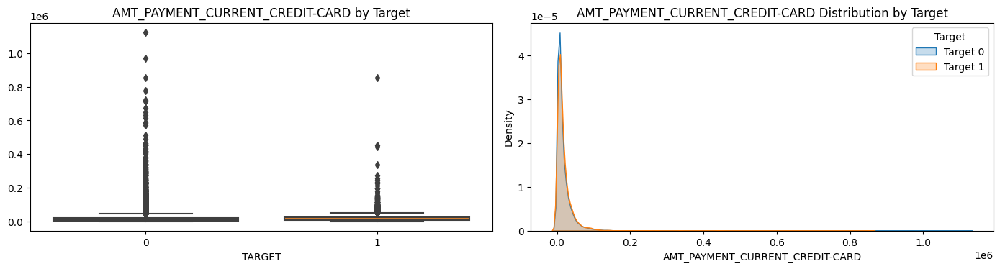

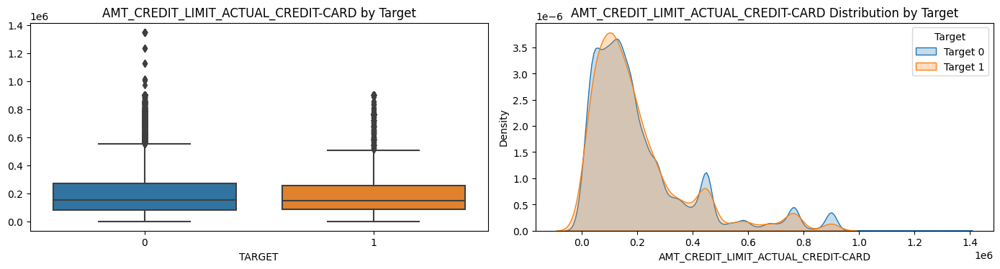

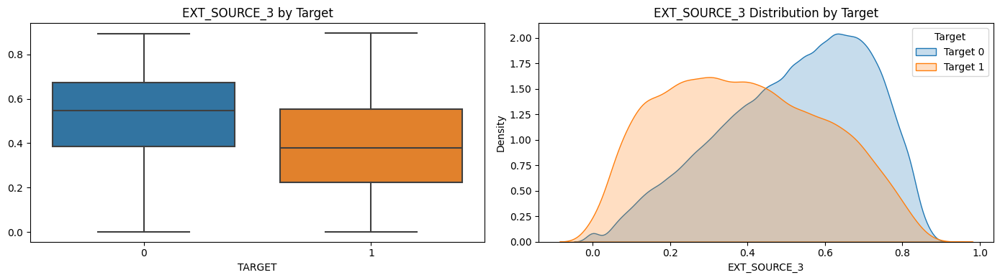

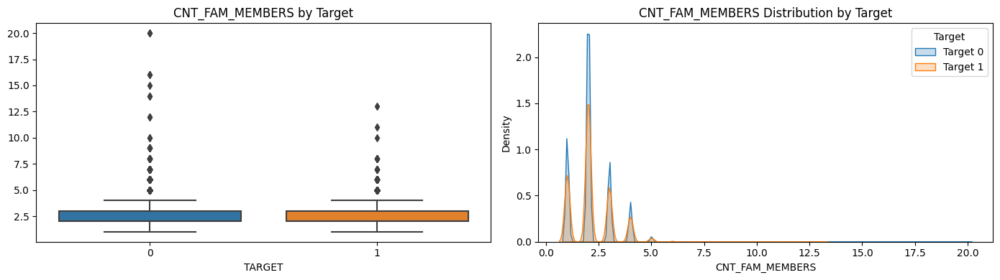

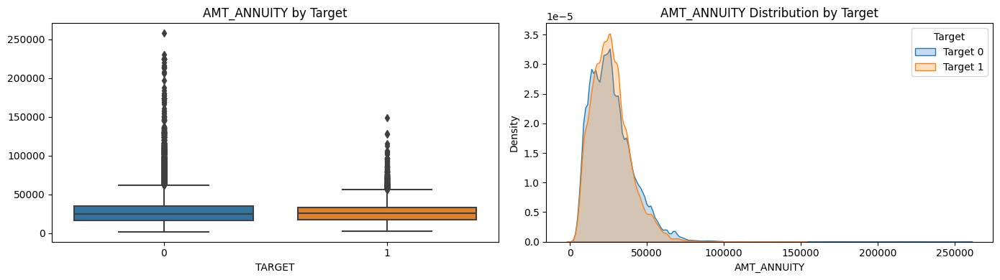

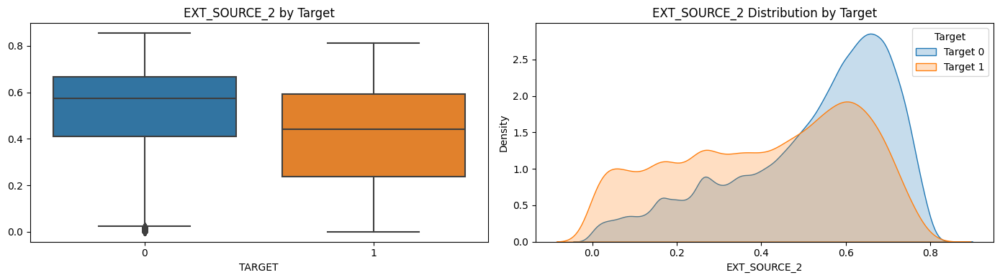

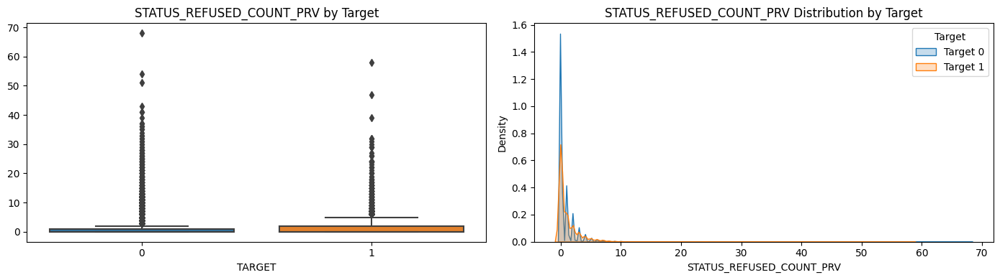

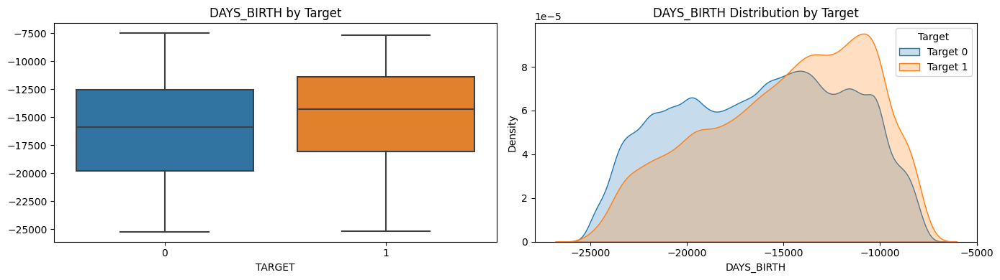

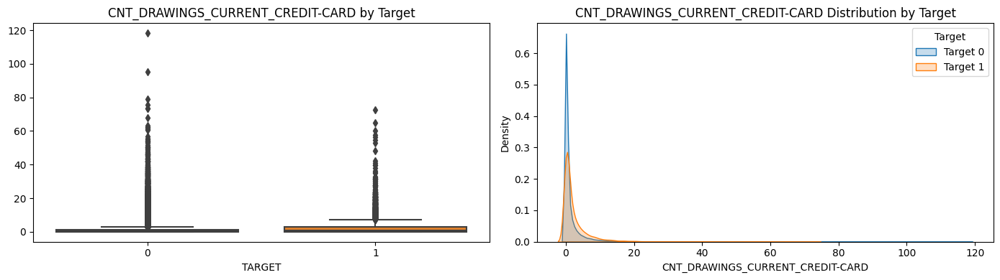

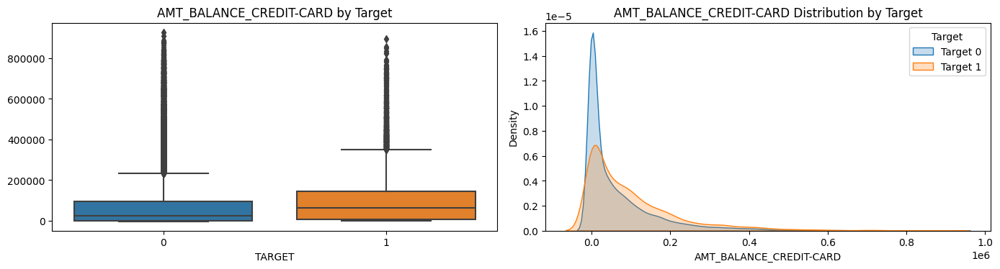

In [27]:
for col in numerical_features:
    tools.plot_eda(df, col, col, continuous=True)

**Insights**:
* Users who defaulted had overall less EXT_Source_3 and EXT_Source 2 than others. Their KDE provde this;
* People who defaulted had more Annuity;
* People who defaulted had more refused prior applications;
* People who defaulted were younger;
* People who defaulted had higher median amount balance in credit card;

### Categorical Data vs Target Analysis

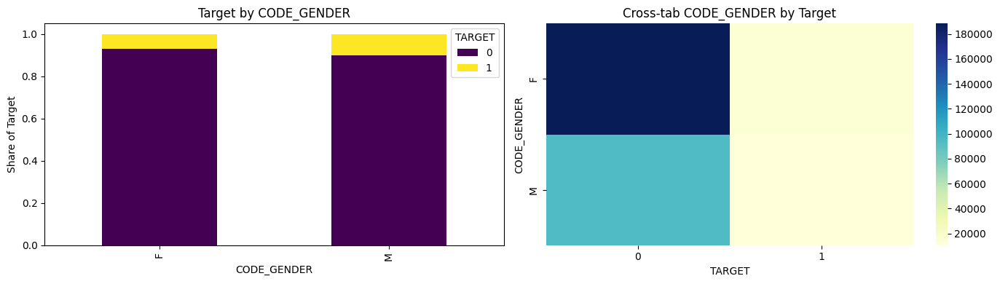

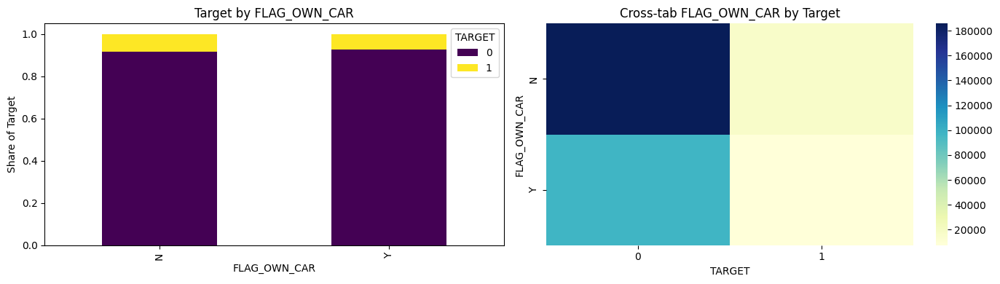

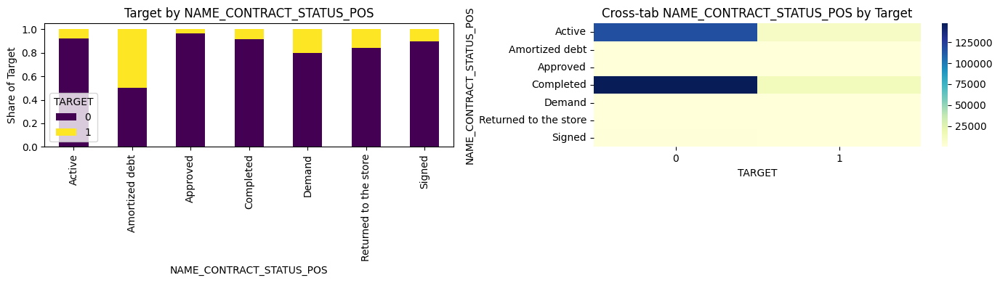

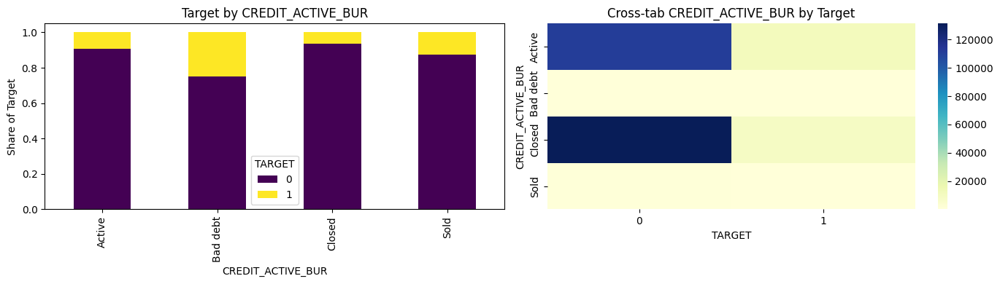

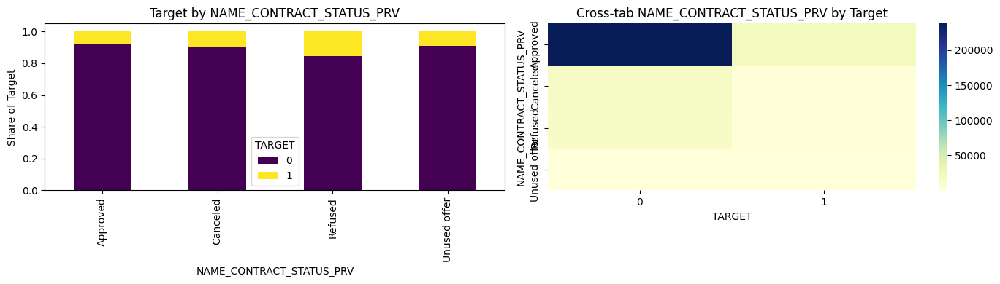

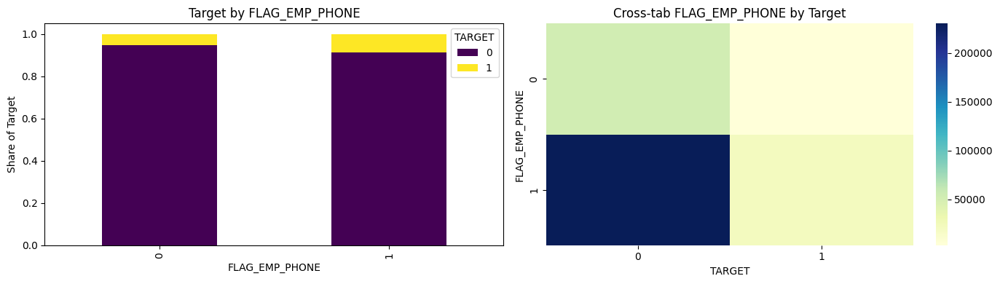

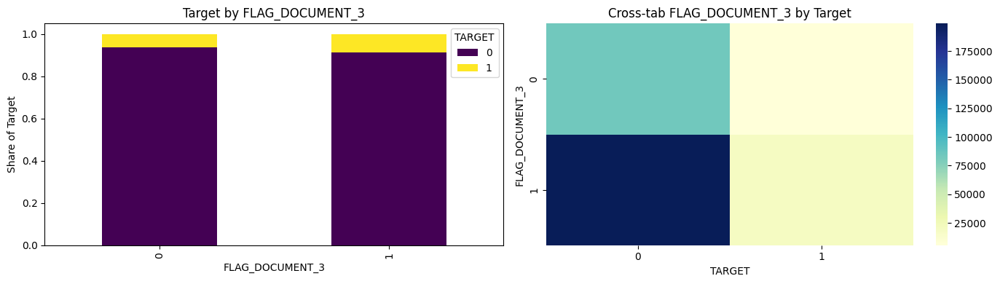

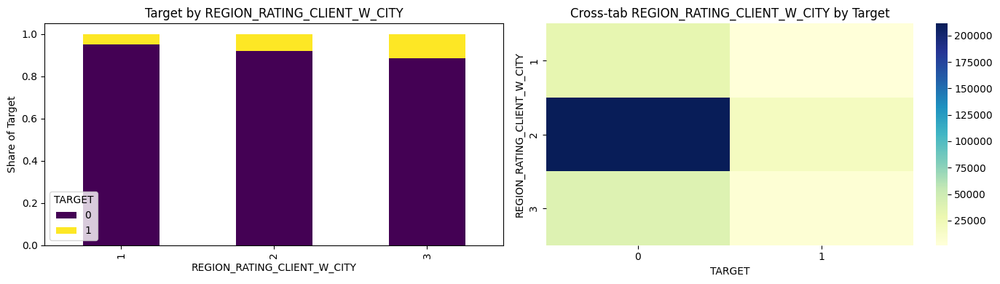

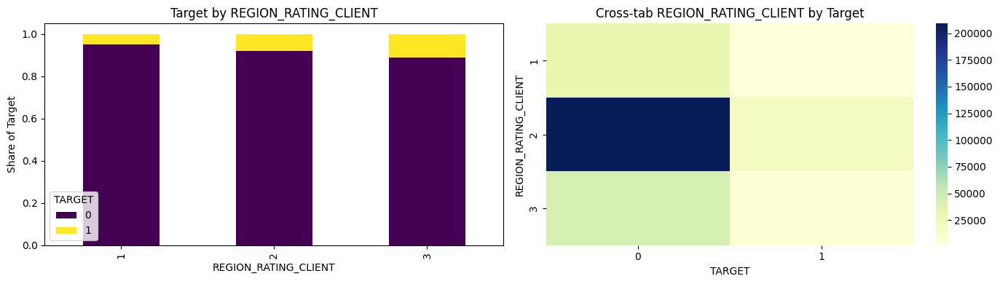

In [37]:
for col in categorical_features:
    tools.plot_eda(df, col, col, continuous=False)

**Insights**:
* There were more Females, although Males are more likely to default; 
* People who defaulted are more likely to not own a car; **perform statistical test**.
* Users who had amortized debt are a lot more likely to default than others;
* People who had Bad Debt in Bureau were more likely to default; **perform statistical inference**.
* People who had Refused Contract before were more likely to default;
* Clients with work phone and document 3 were bit more likely to default;
* Rating 3 city and overall region were more likely to default than others;

**Feature Engineering Ideas:**
* Calculate Annuity to Income Ratio;
* Calculate Annuity Length;
* Calculate Credit - Goods Price;
* Calculate Credit to Goods Price Ratio;
* Calculate Credit to Anuity Ratio
* Calculate Credit to Total Income Ratio.
* Working Life Ratio;
* Income per Family Member;
* Children ratio;
* Interaction between AMT_ANNUITY, EXT_SOURCE_2 and EXT_SOURCE_3.

### Statistical inference #1

* Population: all application to Home Credit.
* Null: there is no difference in default risk based on user owning a car.
* Alternative: there is difference in default risk based on a car ownership.

In [36]:
contingency_table_states = pd.crosstab(df['FLAG_OWN_CAR'], df['TARGET'])

chi, pval, _, _ = stats.chi2_contingency(contingency_table_states.values)

print(f"chi2 statistic: {chi:.2f}")
print(f"p-value: {pval:.3f}")

chi2 statistic: 146.64
p-value: 0.000


**Since p value is < 0.05 we can reject null hypothesis and with 95% confidence confirm that there is significant difference in defaulting risk based on a car ownership.**

### Statistical inference #2

* Population: all applications to Home Credit.
* Null: there is no difference in default risk based on Credit Activity Status in Bureau.
* Alternative: there is difference in default risk Credit Activity Status.

In [38]:
contingency_table_states = pd.crosstab(df['CREDIT_ACTIVE_BUR'], df['TARGET'])

chi, pval, _, _ = stats.chi2_contingency(contingency_table_states.values)

print(f"chi2 statistic: {chi:.2f}")
print(f"p-value: {pval:.3f}")

chi2 statistic: 871.93
p-value: 0.000


**Since p value is < 0.05 we can reject null hypothesis and with 95% confidence confirm that there is significant difference in defaulting risk based on a different Credit Activity Statuses.**

Nice! EDA gave me ample of ideas for further feature engineering. Out next I will encapsulate everything i do into methods, so everything will be reproducable.

### Final Check of the data

In [44]:
tools.isna(df)

SK_ID_CURR                              0.000000
TARGET                                  0.000000
NAME_CONTRACT_TYPE                      0.000000
CODE_GENDER                             0.000000
FLAG_OWN_CAR                            0.000000
FLAG_OWN_REALTY                         0.000000
CNT_CHILDREN                            0.000000
AMT_INCOME_TOTAL                        0.000000
AMT_CREDIT                              0.000000
AMT_ANNUITY                             0.003902
AMT_GOODS_PRICE                         0.090404
NAME_TYPE_SUITE                         0.420153
NAME_INCOME_TYPE                        0.000000
NAME_EDUCATION_TYPE                     0.000000
NAME_FAMILY_STATUS                      0.000000
NAME_HOUSING_TYPE                       0.000000
REGION_POPULATION_RELATIVE              0.000000
DAYS_BIRTH                              0.000000
DAYS_EMPLOYED                           0.000000
DAYS_REGISTRATION                       0.000000
DAYS_ID_PUBLISH     

Ok, since I haven't checked missing data on these features, I will maintain consistency and drop features above 40% threshold. For this I will again drop features from Credit Card dataset.:

AMT_BALANCE_CREDIT-CARD                
AMT_CREDIT_LIMIT_ACTUAL_CREDIT-CARD    
AMT_DRAWINGS_CURRENT_CREDIT-CARD       
AMT_PAYMENT_CURRENT_CREDIT-CARD        
CNT_DRAWINGS_CURRENT_CREDIT-CARD       
SK_DPD_CREDIT-CARD                     
NAME_CONTRACT_STATUS_CREDIT-CARD      

In [45]:
drop_cols = ['AMT_BALANCE_CREDIT-CARD', 
'AMT_CREDIT_LIMIT_ACTUAL_CREDIT-CARD', 
'AMT_DRAWINGS_CURRENT_CREDIT-CARD',
'AMT_PAYMENT_CURRENT_CREDIT-CARD',
'CNT_DRAWINGS_CURRENT_CREDIT-CARD',
'SK_DPD_CREDIT-CARD',
'NAME_CONTRACT_STATUS_CREDIT-CARD']

df.drop(columns=drop_cols, inplace=True)

In [48]:
df.to_csv('final_df.csv')